<center> <img src = https://raw.githubusercontent.com/AndreyRysistov/DatasetsForPandas/main/hh%20label.jpg alt="drawing" style="width:400px;">

# <center> Проект: Анализ резюме из HeadHunter
   

In [124]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import math
import gc
import plotly.graph_objects as go

# Исследование структуры данных

1. Прочитайте данные с помощью библиотеки Pandas. Совет: перед чтением обратите внимание на разделитель внутри файла. 

In [125]:
df = pd.read_csv('hh_res.csv', sep = ';')

2. Выведите несколько первых (последних) строк таблицы, чтобы убедиться в том, что ваши данные не повреждены. Ознакомьтесь с признаками и их структурой.

In [126]:
df.head()

,"Пол, возраст",ЗП,Ищет работу на должность:,"Город, переезд, командировки",Занятость,График,Опыт работы,Последнее/нынешнее место работы,Последняя/нынешняя должность,Образование и ВУЗ,Обновление резюме,Авто
0,"Мужчина , 39 лет , родился 27 ноября 1979",29000 руб.,Системный администратор,"Советск (Калининградская область) , не готов к...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, ва...",Опыт работы 16 лет 10 месяцев Август 2010 — п...,"МАОУ ""СОШ № 1 г.Немана""",Системный администратор,Неоконченное высшее образование 2000 Балтийск...,16.04.2019 15:59,Имеется собственный автомобиль
1,"Мужчина , 60 лет , родился 20 марта 1959",40000 руб.,Технический писатель,"Королев , не готов к переезду , готов к редким...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, уд...",Опыт работы 19 лет 5 месяцев Январь 2000 — по...,Временный трудовой коллектив,"Менеджер проекта, Аналитик, Технический писатель",Высшее образование 1981 Военно-космическая ак...,12.04.2019 08:42,Не указано
2,"Женщина , 36 лет , родилась 12 августа 1982",20000 руб.,Оператор,"Тверь , не готова к переезду , не готова к ком...",полная занятость,полный день,Опыт работы 10 лет 3 месяца Октябрь 2004 — Де...,ПАО Сбербанк,Кассир-операционист,Среднее специальное образование 2002 Профессио...,16.04.2019 08:35,Не указано
3,"Мужчина , 38 лет , родился 25 июня 1980",100000 руб.,Веб-разработчик (HTML / CSS / JS / PHP / базы ...,"Саратов , не готов к переезду , готов к редким...","частичная занятость, проектная работа, полная ...","гибкий график, удаленная работа",Опыт работы 18 лет 9 месяцев Август 2017 — Ап...,OpenSoft,Инженер-программист,Высшее образование 2002 Саратовский государст...,08.04.2019 14:23,Не указано
4,"Женщина , 26 лет , родилась 3 марта 1993",140000 руб.,Региональный менеджер по продажам,"Москва , не готова к переезду , готова к коман...",полная занятость,полный день,Опыт работы 5 лет 7 месяцев Региональный мене...,Мармелад,Менеджер по продажам,Высшее образование 2015 Кгу Психологии и педаг...,22.04.2019 10:32,Не указано


3. Выведите основную информацию о числе непустых значений в столбцах и их типах в таблице.

4. Обратите внимание на информацию о числе непустых значений.

In [127]:
#выводим инфо о непустых значениях столбцов
df.info()
#отдельно подсчитываем пустые ячейки
df.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44744 entries, 0 to 44743
Data columns (total 12 columns):
 #   Column                           Non-Null Count  Dtype 
---  ------                           --------------  ----- 
 0   Пол, возраст                     44744 non-null  object
 1   ЗП                               44744 non-null  object
 2   Ищет работу на должность:        44744 non-null  object
 3   Город, переезд, командировки     44744 non-null  object
 4   Занятость                        44744 non-null  object
 5   График                           44744 non-null  object
 6   Опыт работы                      44576 non-null  object
 7   Последнее/нынешнее место работы  44743 non-null  object
 8   Последняя/нынешняя должность     44742 non-null  object
 9   Образование и ВУЗ                44744 non-null  object
 10  Обновление резюме                44744 non-null  object
 11  Авто                             44744 non-null  object
dtypes: object(12)
memory usage: 4.1+

Пол, возраст                         0
ЗП                                   0
Ищет работу на должность:            0
Город, переезд, командировки         0
Занятость                            0
График                               0
Опыт работы                        168
Последнее/нынешнее место работы      1
Последняя/нынешняя должность         2
Образование и ВУЗ                    0
Обновление резюме                    0
Авто                                 0
dtype: int64

5. Выведите основную статистическую информацию о столбцах.


In [128]:
df.describe()

,"Пол, возраст",ЗП,Ищет работу на должность:,"Город, переезд, командировки",Занятость,График,Опыт работы,Последнее/нынешнее место работы,Последняя/нынешняя должность,Образование и ВУЗ,Обновление резюме,Авто
count,44744,44744,44744,44744,44744,44744,44576,44743,44742,44744,44744,44744
unique,16003,690,14929,10063,38,47,44413,30214,16927,40148,18838,2
top,"Мужчина , 32 года , родился 17 сентября 1986",50000 руб.,Системный администратор,"Москва , не готов к переезду , не готов к кома...",полная занятость,полный день,Опыт работы 10 лет 8 месяцев Апрель 2018 — по...,Индивидуальное предпринимательство / частная п...,Системный администратор,Высшее образование 1987 Военный инженерный Кра...,07.05.2019 09:50,Не указано
freq,18,4064,3099,1261,30026,22727,3,935,2062,4,25,32268


# Преобразование данных

1. Начнем с простого - с признака **"Образование и ВУЗ"**. Его текущий формат это: **<Уровень образования год выпуска ВУЗ специальность...>**. Например:
* Высшее образование 2016 Московский авиационный институт (национальный исследовательский университет)...
* Неоконченное высшее образование 2000  Балтийская государственная академия рыбопромыслового флота…
Нас будет интересовать только уровень образования.

Создайте с помощью функции-преобразования новый признак **"Образование"**, который должен иметь 4 категории: "высшее", "неоконченное высшее", "среднее специальное" и "среднее".

Выполните преобразование, ответьте на контрольные вопросы и удалите признак "Образование и ВУЗ".

Совет: обратите внимание на структуру текста в столбце **"Образование и ВУЗ"**. Гарантируется, что текущий уровень образования соискателя всегда находится в первых 2ух слов и начинается с заглавной буквы. Воспользуйтесь этим.

*Совет: проверяйте полученные категории, например, с помощью метода unique()*


In [129]:
#преобразовали столбец в строковый тип
df['Образование и ВУЗ'] = df['Образование и ВУЗ'].astype('string')
#отрезали два первых слова
df['Образование'] = df['Образование и ВУЗ'].str.split().str[0:2]
#собрали данные обратно, но без лишней информации
df['Образование'] = df['Образование'].apply(lambda x: ', '.join(map(str,x)))
#для удобства убрали запятую
df['Образование'] = df['Образование'].str.replace(',', '')
#немного схитрили и просто подсчитали значения
df['Образование'].value_counts()          
#далили ненужный столбец Образование и ВУЗ
#если снова запустить эту ячейку, выдаст ошибку KeyError
df = df.drop('Образование и ВУЗ', axis = 1)

2. Теперь нас интересует столбец **"Пол, возраст"**. Сейчас он представлен в формате **<Пол , возраст , дата рождения >**. Например:
* Мужчина , 39 лет , родился 27 ноября 1979 
* Женщина , 21 год , родилась 13 января 2000
Как вы понимаете, нам необходимо выделить каждый параметр в отдельный столбец.

Создайте два новых признака **"Пол"** и **"Возраст"**. При этом важно учесть:
* Признак пола должен иметь 2 уникальных строковых значения: 'М' - мужчина, 'Ж' - женщина. 
* Признак возраста должен быть представлен целыми числами.

Выполните преобразование, ответьте на контрольные вопросы и удалите признак **"Пол, возраст"** из таблицы.

*Совет: обратите внимание на структуру текста в столбце, в части на то, как разделены параметры пола, возраста и даты рождения между собой - символом ' , '. 
Гарантируется, что структура одинакова для всех строк в таблице. Вы можете воспользоваться этим.*


In [130]:
#преобразуем object в строку, чтобы работать дальше
df['Пол, возраст'] = df['Пол, возраст'].astype('string')
#отрезаем отдельно пол, очищаем его от лишнего и преобразуем в короткую форму(M/Ж)
df['Пол'] = df['Пол, возраст'].str.split().str[0:1].astype('string')
df['Пол'] = df['Пол'].str[2:3]
df['Пол'] = df['Пол'].str.replace('Мужчина', 'М')
df['Пол'] = df['Пол'].str.replace('Женщина', 'Ж')
#отрезаем возраст. очищаем от лишнего и преобразуем в int8
df['Возраст'] = df['Пол, возраст'].str.split().str[2:3].astype('string').str[2:4].astype(np.int8)

#Сколько процентов женских резюме представлено в наших данных? Ответ округлите до сотых.
fem_res = df[df['Пол'] == 'Ж']
fem_res = round(fem_res.shape[0] / df.shape[0] * 100, 2)
#Чему равен средний возраст соискателей? Ответ округлите до десятых.
average_age_res = round(df['Возраст'].mean(), 1)

print(f'Процент женских резюме {fem_res} %')
print(f'Средний возраст соискателя {average_age_res} лет')
df = df.drop('Пол, возраст', axis = 1)

Процент женских резюме 19.07 %
Средний возраст соискателя 32.2 лет


3. Следующим этапом преобразуем признак **"Опыт работы"**. Его текущий формат - это: **<Опыт работы: n лет m месяцев, периоды работы в различных компаниях…>**. 

Из столбца нам необходимо выделить общий опыт работы соискателя в месяцах, новый признак назовем "Опыт работы (месяц)"

Для начала обсудим условия решения задачи:
* Во-первых, в данном признаке есть пропуски. Условимся, что если мы встречаем пропуск, оставляем его как есть (функция-преобразование возвращает NaN)
* Во-вторых, в данном признаке есть скрытые пропуски. Для некоторых соискателей в столбце стоит значения "Не указано". Их тоже обозначим как NaN (функция-преобразование возвращает NaN)
* В-третьих, нас не интересует информация, которая описывается после указания опыта работы (периоды работы в различных компаниях)
* В-четвертых, у нас есть проблема: опыт работы может быть представлен только в годах или только месяцах. Например, можно встретить следующие варианты:
    * Опыт работы 3 года 2 месяца…
    * Опыт работы 4 года…
    * Опыт работы 11 месяцев…
    * Учитывайте эту особенность в вашем коде

Учитывайте эту особенность в вашем коде

В результате преобразования у вас должен получиться столбец, содержащий информацию о том, сколько месяцев проработал соискатель.
Выполните преобразование, ответьте на контрольные вопросы и удалите столбец **"Опыт работы"** из таблицы.


In [131]:
#функция преобразования столбца
def prepare_data(lst):
    tmp = []
    if not lst:
        return np.nan
    for i in lst:
        if i.isdigit(): 
            tmp.append(i)
    if len(tmp) == 2 and ('лет' in lst or 'год' in lst or 'года' in lst) and ('месяцев' in lst or 'месяц' in lst or 'месяца' in lst):
        return int(int(tmp[0]) * 12 + int(tmp[1]))
    if len(tmp) == 2 and ('лет' in lst or 'год' in lst or 'года' in lst):
        return int(int(tmp[0]) * 12)
    if len(tmp) == 2 and ('месяцев' in lst or 'месяц' in lst or 'месяца' in lst):
        return int(tmp[0])
    
    if len(tmp) == 1 and ('лет' in lst or 'год' in lst or 'года' in lst):
        return int(int(tmp[0]) * 12)
    if len(tmp) == 1 and ('месяцев' in lst or 'месяц' in lst or 'месяца' in lst):
        return int(tmp[0]) 
    return 0
#подготовка данных: обработали пропущенные, отрезали лишнее, применили функциб преобразования
df['Опыт работы'] = df['Опыт работы'].replace('', np.nan)
df['Опыт работы'] = df['Опыт работы'].fillna(False)
df['Опыт работы'] = df['Опыт работы'].astype('string')
df['Опыт работы'] = df['Опыт работы'].str.split().str[2:6]
df['Опыт работы в месяцах'] = df['Опыт работы'].apply(prepare_data)
skill_month_median = df['Опыт работы в месяцах'].median()
print(f'Медианный опыт работы в месяцах: {skill_month_median}')
df = df.drop('Опыт работы', axis = 1)

Медианный опыт работы в месяцах: 100.0


4. Хорошо идем! Следующий на очереди признак "Город, переезд, командировки". Информация в нем представлена в следующем виде: **<Город , (метро) , готовность к переезду (города для переезда) , готовность к командировкам>**. В скобках указаны необязательные параметры строки. Например, можно встретить следующие варианты:

* Москва , не готов к переезду , готов к командировкам
* Москва , м. Беломорская , не готов к переезду, не готов к командировкам
* Воронеж , готов к переезду (Сочи, Москва, Санкт-Петербург) , готов к командировкам

Создадим отдельные признаки **"Город"**, **"Готовность к переезду"**, **"Готовность к командировкам"**. При этом важно учесть:

* Признак **"Город"** должен содержать только 4 категории: "Москва", "Санкт-Петербург" и "город-миллионник" (их список ниже), остальные обозначьте как "другие".

    Список городов-миллионников:
    
   <code>million_cities = ['Новосибирск', 'Екатеринбург','Нижний Новгород','Казань', 'Челябинск','Омск', 'Самара', 'Ростов-на-Дону', 'Уфа', 'Красноярск', 'Пермь', 'Воронеж','Волгоград']
    </code>
    Инфорация о метро, рядом с которым проживает соискатель нас не интересует.
* Признак **"Готовность к переезду"** должен иметь два возможных варианта: True или False. Обратите внимание, что возможны несколько вариантов описания готовности к переезду в признаке "Город, переезд, командировки". Например:
    * … , готов к переезду , …
    * … , не готова к переезду , …
    * … , готова к переезду (Москва, Санкт-Петербург, Ростов-на-Дону)
    * … , хочу переехать (США) , …
    
    Нас интересует только сам факт возможности или желания переезда.
* Признак **"Готовность к командировкам"** должен иметь два возможных варианта: True или False. Обратите внимание, что возможны несколько вариантов описания готовности к командировкам в признаке "Город, переезд, командировки". Например:
    * … , готов к командировкам , … 
    * … , готова к редким командировкам , …
    * … , не готов к командировкам , …
    
    Нас интересует только сам факт готовности к командировке.
    
    Еще один важный факт: при выгрузки данных у некоторых соискателей "потерялась" информация о готовности к командировкам. Давайте по умолчанию будем считать, что такие соискатели не готовы к командировкам.
    
Выполните преобразования и удалите столбец **"Город, переезд, командировки"** из таблицы.

*Совет: обратите внимание на то, что структура текста может меняться в зависимости от указания ближайшего метро. Учите это, если будете использовать порядок слов в своей программе.*


In [132]:
df['Город'] = df['Город, переезд, командировки'].str.split().str[0:1]
df['Город'] = df['Город'].astype('string')
df['Город'] = df['Город'].str[2:-2]

million_cities = ['Новосибирск', 'Екатеринбург','Нижний Новгород','Казань', 'Челябинск','Омск', 'Самара', 'Ростов-на-Дону', 'Уфа', 'Красноярск', 'Пермь', 'Воронеж','Волгоград']
#преобразуем города в категории Москва, Санкт - Петербург, миллионники, провинция
def city(c):
    if c in million_cities:
        return 'город-миллионник'
    if c == 'Москва' or c == 'Санкт-Петербург':
        return c
    return 'другие'
df['Город'] = df['Город'].apply(city)
#подсчитываем долю соискателей из Санкт - Петербурга
value = math.ceil(df[df['Город'] == 'Санкт-Петербург'].value_counts().sum() / df.shape[0] * 100)
print(f'Доля соискателей из Санкт - Петербурга(%): {value} %')

df['Готовность к переезду'] = df['Город, переезд, командировки'].str.split().str[1:]
#функция преобразования столбца Готовность к переезду
def relocation(c):
    if 'не' in c and 'готов' in c and 'переезду' in c:
        return False
    if 'не' in c and 'готова' in c and 'переезду' in c:
        return False
    return True
        
#преобразованиe столбца Готовность к переезду    
df['Готовность к переезду'] = df['Готовность к переезду'].apply(relocation)

df['Готовность к командировкам'] = df['Город, переезд, командировки'].str.split().str[1:]
#функция преобразования столбца Готовность к командировкам
def chill(c):
    if  'готов' in c and 'к' in c and 'командировкам' in c:
        return True
    if  'готова' in c and 'к' in c and 'командировкам' in c:
        return True
    if  'готов' in c and 'к' in c and 'командировкам' in c and 'редким' in c:
        return True
    if  'готова' in c and 'к' in c and 'командировкам' in c  and 'редким' in c:
        return True
    return False
#преобразованиe столбца Готовность к командировкам       
df['Готовность к командировкам'] = df['Готовность к командировкам'].apply(chill)
#делаем выборку тех, кто готов к переезду и командировкам
comm = (df['Готовность к переезду'] == True) & (df['Готовность к командировкам'] == True)
tmp_df = df[comm]

print(f'Доля готовых к переезду и командировкам: {math.floor(tmp_df.shape[0] / df.shape[0] * 100 )} %')
df = df.drop('Город, переезд, командировки', axis = 1)

del million_cities
del tmp_df
gc.collect()

Доля соискателей из Санкт - Петербурга(%): 11 %
Доля готовых к переезду и командировкам: 32 %


35

5. Рассмотрим поближе признаки **"Занятость"** и **"График"**. Сейчас признаки представляют собой набор категорий желаемой занятости (полная занятость, частичная занятость, проектная работа, волонтерство, стажировка) и желаемого графика работы (полный день, сменный график, гибкий график, удаленная работа, вахтовый метод).
На сайте hh.ru соискатель может указывать различные комбинации данных категорий, например:
* полная занятость, частичная занятость
* частичная занятость, проектная работа, волонтерство
* полный день, удаленная работа
* вахтовый метод, гибкий график, удаленная работа, полная занятость

Такой вариант признаков имеет множество различных комбинаций, а значит множество уникальных значений, что мешает анализу. Нужно это исправить!

Давайте создадим признаки-мигалки для каждой категории: если категория присутствует в списке желаемых соискателем, то в столбце на месте строки рассматриваемого соискателя ставится True, иначе - False.

Такой метод преобразования категориальных признаков называется One Hot Encoding и его схема представлена на рисунке ниже:
<img src=https://raw.githubusercontent.com/AndreyRysistov/DatasetsForPandas/main/ohe.jpg>
Выполните данное преобразование для признаков "Занятость" и "График", ответьте на контрольные вопросы, после чего удалите их из таблицы

In [133]:
#обрабатываем столбец Занятость, формируем новые признаки, после удаляем столбец
df['Занятость'].astype('string')

df['Полная занятость'] = df['Занятость'].apply(lambda x: 'полная занятость' in x)
df['Частичная занятость'] = df['Занятость'].apply(lambda x: 'частичная занятость' in x)
df['Проектная работа'] = df['Занятость'].apply(lambda x: 'проектная работа' in x)
df['Стажировка'] = df['Занятость'].apply(lambda x: 'стажировка' in x)
df['Волонтерство'] = df['Занятость'].apply(lambda x: 'волонтерство' in x)


comm = (df['Проектная работа'] == True) & (df['Волонтерство'] == True)
tmp_df = df[comm]
out = tmp_df['Волонтерство'].shape[0]
print(f'К волонтерству и проектной работе готовы {out} соискателей' )

df = df.drop('Занятость', axis = 1)

#обрабатываем столбец График, формируем новые признаки, после удаляем столбец
df['График'].astype('string')

df['вахтовый метод'] = df['График'].apply(lambda x: 'вахтовый метод' in x)
df['гибкий график'] = df['График'].apply(lambda x: 'гибкий график' in x)
df['удалённая работа'] = df['График'].apply(lambda x: 'удаленная работа' in x)
df['полная занятость'] = df['График'].apply(lambda x: 'полная занятость' in x)


comm = (df['вахтовый метод'] == True) & (df['гибкий график'] == True)
tmp_df = df[comm]
out = tmp_df['вахтовый метод'].shape[0]
print(f'К вахтовому методу и гибкому графику готовы {out} соискателей' )

df = df.drop('График', axis = 1)
del tmp_df


К волонтерству и проектной работе готовы 436 соискателей
К вахтовому методу и гибкому графику готовы 2311 соискателей


6. (2 балла) Наконец, мы добрались до самого главного и самого важного - признака заработной платы **"ЗП"**. 
В чем наша беда? В том, что помимо желаемой заработной платы соискатель указывает валюту, в которой он бы хотел ее получать, например:
* 30000 руб.
* 50000 грн.
* 550 USD

Нам бы хотелось видеть заработную плату в единой валюте, например, в рублях. Возникает вопрос, а где взять курс валют по отношению к рублю?

На самом деле язык Python имеет в арсенале огромное количество возможностей получения данной информации, от обращения к API Центробанка, до использования специальных библиотек, например pycbrf. Однако, это не тема нашего проекта.

Поэтому мы пойдем в лоб: обратимся к специальным интернет-ресурсам для получения данных о курсе в виде текстовых файлов. Например, MDF.RU, данный ресурс позволяет удобно экспортировать данные о курсах различных валют и акций за указанные периоды в виде csv файлов. Мы уже сделали выгрузку курсов валют, которые встречаются в наших данных за период с 29.12.2017 по 05.12.2019. Скачать ее вы можете **на платформе**

Создайте новый DataFrame из полученного файла. В полученной таблице нас будут интересовать столбцы:
* "currency" - наименование валюты в ISO кодировке,
* "date" - дата, 
* "proportion" - пропорция, 
* "close" - цена закрытия (последний зафиксированный курс валюты на указанный день).


Перед вами таблица соответствия наименований иностранных валют в наших данных и их общепринятых сокращений, которые представлены в нашем файле с курсами валют. Пропорция - это число, за сколько единиц валюты указан курс в таблице с курсами. Например, для казахстанского тенге курс на 20.08.2019 составляет 17.197 руб. за 100 тенге, тогда итоговый курс равен - 17.197 / 100 = 0.17197 руб за 1 тенге.
Воспользуйтесь этой информацией в ваших преобразованиях.

<img src=https://raw.githubusercontent.com/AndreyRysistov/DatasetsForPandas/main/table.jpg>


Осталось только понять, откуда брать дату, по которой определяется курс? А вот же она - в признаке **"Обновление резюме"**, в нем содержится дата и время, когда соискатель выложил текущий вариант своего резюме. Нас интересует только дата, по ней бы и будем сопоставлять курсы валют.

Теперь у нас есть вся необходимая информация для того, чтобы создать признак "ЗП (руб)" - заработная плата в рублях.

После ответа на контрольные вопросы удалите исходный столбец заработной платы "ЗП" и все промежуточные столбцы, если вы их создавали.

Итак, давайте обсудим возможный алгоритм преобразования: 
1. Перевести признак "Обновление резюме" из таблицы с резюме в формат datetime и достать из него дату. В тот же формат привести признак "date" из таблицы с валютами.
2. Выделить из столбца "ЗП" сумму желаемой заработной платы и наименование валюты, в которой она исчисляется. Наименование валюты перевести в стандарт ISO согласно с таблицей выше.
3. Присоединить к таблице с резюме таблицу с курсами по столбцам с датой и названием валюты (подумайте, какой тип объединения надо выбрать, чтобы в таблице с резюме сохранились данные о заработной плате, изначально представленной в рублях). Значение close для рубля заполнить единицей 1 (курс рубля самого к себе)
4. Умножить сумму желаемой заработной платы на присоединенный курс валюты (close) и разделить на пропорцию (обратите внимание на пропуски после объединения в этих столбцах), результат занести в новый столбец "ЗП (руб)".


In [134]:
currency = pd.read_csv('ExchangeRates.csv', sep=',')
#преобразуем дату фиксации курса в формат datetime чтобы привести эту дичь к нормальному формату
currency['date'] = pd.to_datetime(currency['date'], format = 'mixed')
#вытягиваем дату из столбца Обновление резюме
df['Обновление резюме'] = pd.to_datetime(df['Обновление резюме'], format = 'mixed')
df['Обновление резюме'] = df['Обновление резюме'].astype('string')
df['Обновление резюме'] = df['Обновление резюме'].str.split().str[0:1]
df['Обновление резюме'] = df['Обновление резюме'].astype('string')
df['Обновление резюме'] = df['Обновление резюме'].str[2:12]
#преобразуем дату фиксации курса обратно в строку и пересчитываем заранее курс на 1 единицу валюты
currency['date'] = currency['date'].astype('string')
currency['close'] = currency['close'] / currency['proportion']
#вытягиваем из столбца ЗП значения в единицах валюты и отдельно вид валюты
#также делаем замену с строки на трехзначный код(например, руб на RUB) чтобы схлопнуть с курсами валют
df['ЗП'] = df['ЗП'].astype('string')
df['ЗП_З'] = df['ЗП'].str.split().str[0:1]
df['ЗП_В'] = df['ЗП'].str.split().str[1:2]
df['ЗП_З'] = df['ЗП_З'].astype('string')
df['ЗП_В'] = df['ЗП_В'].astype('string')
df['ЗП_В'] = df['ЗП_В'].str[2:5]
df['ЗП_З'] = df['ЗП_З'].str[2:-2]
df['ЗП_В'] = df['ЗП_В'].replace('руб','RUB')
df['ЗП_В'] = df['ЗП_В'].replace('бел','BYN')
df['ЗП_В'] = df['ЗП_В'].replace('грн','UAH')
df['ЗП_В'] = df['ЗП_В'].replace('сум','UZS')
#нужны общие столбцы по currency и df, иначе не схлопнется, впоследствии мы все лишнее удалим из df
df['date'] = df['Обновление резюме']
df['currency'] = df['ЗП_В']

merged_df = pd.merge(df[['ЗП_З', 'currency', 'date']], currency[['currency', 'date', 'close']], on=['date', 'currency'], how='left')
merged_df= merged_df.fillna(1)
merged_df['ЗП_З'] = merged_df['ЗП_З'].astype(np.int64)
df['ЗП(руб)'] = merged_df['ЗП_З'] * merged_df['close']
out = df['ЗП(руб)'].median()
print(f'Медианная зарплата в рублях составляет {out} рублей' )
#удаляем лишние столбцы df
df = df.drop('ЗП', axis = 1)
df = df.drop('ЗП_З', axis = 1)
df = df.drop('ЗП_В', axis = 1)
df = df.drop('date', axis = 1)
df = df.drop('currency', axis = 1)
#удаляем лишние фреймы и вызываем сборщик мусора, так как к этому времени мы порядком набрали памяти
del merged_df
del currency
gc.collect()

Медианная зарплата в рублях составляет 59019.0 рублей


76

# Исследование зависимостей в данных

1. Постройте распределение признака **"Возраст"**. Опишите распределение, отвечая на следующие вопросы: чему равна мода распределения, каковы предельные значения признака, в каком примерном интервале находится возраст большинства соискателей? Есть ли аномалии для признака возраста, какие значения вы бы причислили к их числу?
*Совет: постройте гистограмму и коробчатую диаграмму рядом.*

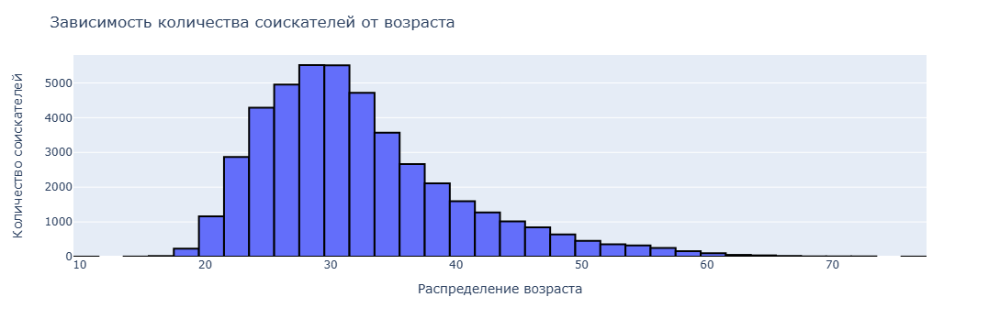

Мода равна 30 лет по графику
Перепроверяем через pandas: 30 лет


In [135]:
age_plot = px.histogram(df, x = 'Возраст', nbins = 55)
age_plot.update_layout(
    yaxis_title="Количество соискателей", 
    xaxis_title="Распределение возраста",
    title = 'Зависимость количества соискателей от возраста')
age_plot.update_traces(marker_line_color='black',
                  marker_line_width=2)
age_plot.show()

print('Мода равна 30 лет по графику')
mode_pand = df['Возраст'].mode()[0]
print(f'Перепроверяем через pandas: {mode_pand} лет')

del age_plot

Самое часто встречающееся значение - 30, значит самая большая доля соискателей идет возраста 30 лет

2. Постройте распределение признака **"Опыт работы (месяц)"**. Опишите данное распределение, отвечая на следующие вопросы: чему равна мода распределения, каковы предельные значения признака, в каком примерном интервале находится опыт работы большинства соискателей? Есть ли аномалии для признака опыта работы, какие значения вы бы причислили к их числу?
*Совет: постройте гистограмму и коробчатую диаграмму рядом.*

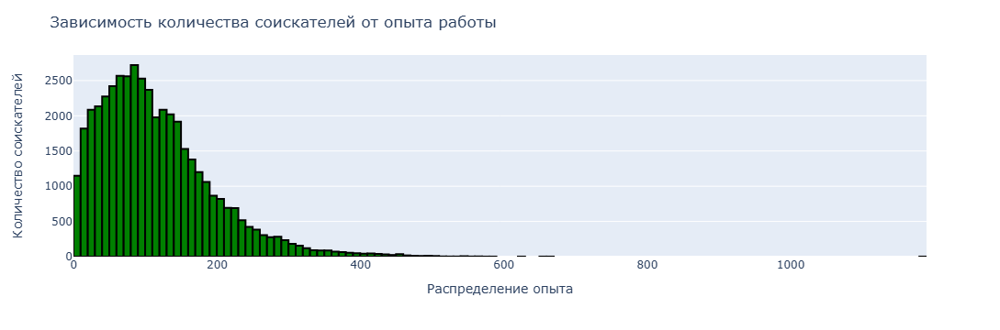

Опыт работы модальный лежит в диапазоне от 80 до 89 месяцев, это не совсем то, что мы хотели
Найдем через pandas: мода равна 81.0 месяц
Найдем медиану опыта через pandas: равна 100.0 месяц
Это значит, что 50% соискателей имеют опыт менее 100.0 месяцев
Найдем 25 квартиль опыта через pandas: равна 57.0 месяц
Найдем 75 квартиль опыта через pandas: равна 154.0 месяц
Найдем минимальный опыт через pandas: равна 1.0 месяц
Найдем максимальный опыт через pandas: равна 1188.0 месяц
Попробуем визуализировать:


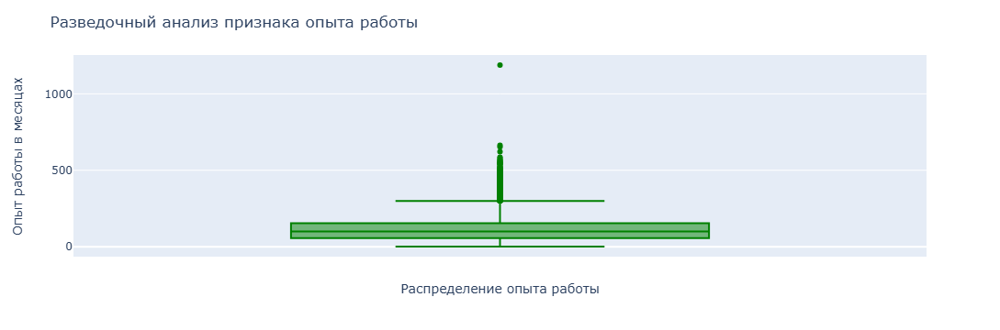

А теперь откинем значения выше верхней границы межквартильного размаха и построим коробку заново


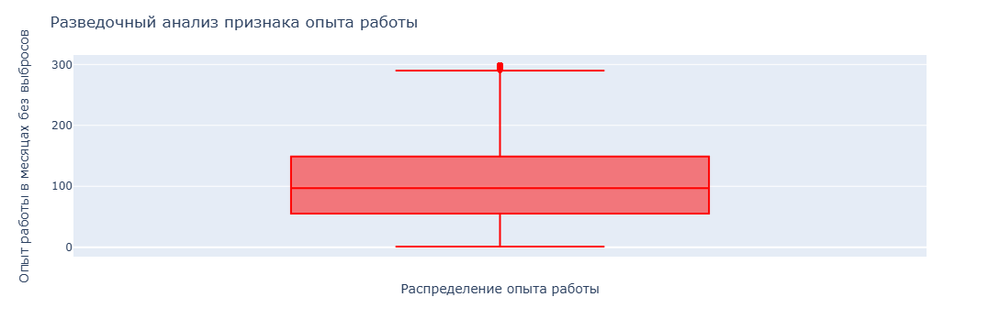

Уже лучше, при этом медиана и 25 процентиль и 75 процентиль почти не пострадали
Это значит, что основное распределение не нарушено


2287

In [136]:
skill_plot = px.histogram(df, x = 'Опыт работы в месяцах', nbins = 150, color_discrete_sequence=['green'])
skill_plot.update_layout(
    yaxis_title="Количество соискателей", 
    xaxis_title="Распределение опыта",
    title = 'Зависимость количества соискателей от опыта работы')
skill_plot.update_traces(marker_line_color='black',
                  marker_line_width=2)
skill_plot.show()

print('Опыт работы модальный лежит в диапазоне от 80 до 89 месяцев, это не совсем то, что мы хотели')
mode_pand = df['Опыт работы в месяцах'].mode()[0]
print(f'Найдем через pandas: мода равна {mode_pand} месяц')
median_pand = df['Опыт работы в месяцах'].median()
print(f'Найдем медиану опыта через pandas: равна {median_pand} месяц')
print(f'Это значит, что 50% соискателей имеют опыт менее {median_pand} месяцев')
perc25_pand = df['Опыт работы в месяцах'].quantile(0.25)
print(f'Найдем 25 квартиль опыта через pandas: равна {perc25_pand} месяц')
perc75_pand = df['Опыт работы в месяцах'].quantile(0.75)
print(f'Найдем 75 квартиль опыта через pandas: равна {perc75_pand} месяц')
min_pand = df['Опыт работы в месяцах'].min()
print(f'Найдем минимальный опыт через pandas: равна {min_pand} месяц')
max_pand = df['Опыт работы в месяцах'].max()
print(f'Найдем максимальный опыт через pandas: равна {max_pand} месяц')
print('Попробуем визуализировать:')

box_plot = px.box(df, y='Опыт работы в месяцах', color_discrete_sequence=['green']) 
box_plot.update_layout(
    xaxis_title="Распределение опыта работы",
    yaxis_title="Опыт работы в месяцах",
    title = 'Разведочный анализ признака опыта работы'
)
box_plot.show()

print('А теперь откинем значения выше верхней границы межквартильного размаха и построим коробку заново')

tmp_df = df[df['Опыт работы в месяцах'] <= 299]
box_plot1 = px.box(tmp_df, y='Опыт работы в месяцах', color_discrete_sequence=['red']) 
box_plot1.update_layout(
    xaxis_title="Распределение опыта работы",
    yaxis_title="Опыт работы в месяцах без выбросов",
    title = 'Разведочный анализ признака опыта работы'
)
box_plot1.show()
print('Уже лучше, при этом медиана и 25 процентиль и 75 процентиль почти не пострадали')
print('Это значит, что основное распределение не нарушено')

del box_plot
del tmp_df
del box_plot1
del skill_plot
gc.collect()

1) Большая часть соискателей имеет опыт от 57 месяцев до 154 месяцев
2) Чаще всего на рынок труда выходят соискатели с опытом 81 месяц
3) Опыт работы 99 лет это жесть, скорее всего, это ошибка, столько не живут(вообще upper_fence показывает, что все, что от 300 месяцев - частные случаи и выбросы)
4) Конкретно для данного случая коробчатая диаграмма не самое удачное решение из - за большого количества выбросов, так как все, что от 300 месяцев - выбросы и это портит визуализацию.
Но если очень хочется, можно откинуть выбросы и построить заново, будет наглядно и красиво

3. Постройте распределение признака **"ЗП (руб)"**. Опишите данное распределение, отвечая на следующие вопросы: каковы предельные значения признака, в каком примерном интервале находится заработная плата большинства соискателей? Есть ли аномалии для признака возраста? Обратите внимание на гигантские размеры желаемой заработной платы.
*Совет: постройте гистограмму и коробчатую диаграмму рядом.*


Найдем через pandas: мода равна 50000.0 рублей
Найдем медиану зп через pandas: равна 59995.0 рублей
Это значит, что 50% соискателей хотят зп менее 59995.0 рублей
Найдем 25 квартиль опыта через pandas: равна 38000.0 рублей
Найдем 75 квартиль опыта через pandas: равна 95000.0 рублей
Найдем минимальную зп через pandas: равна 1000.0 рублей
Найдем максимальную зп через pandas: равна 1000000.0 рублей
Найдем число соискателей с ожиданиями зп > 1.000.000 рублей через pandas: равна 0 человек
Попробуем визуализировать:


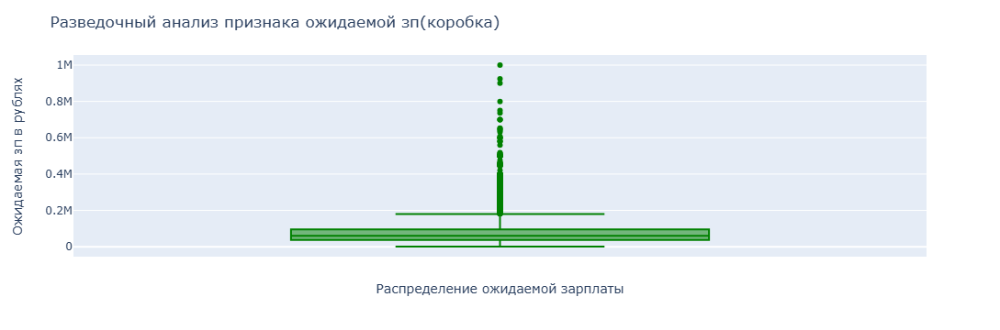

А теперь откинем значения выше верхней границы межквартильного размаха и построим коробку заново


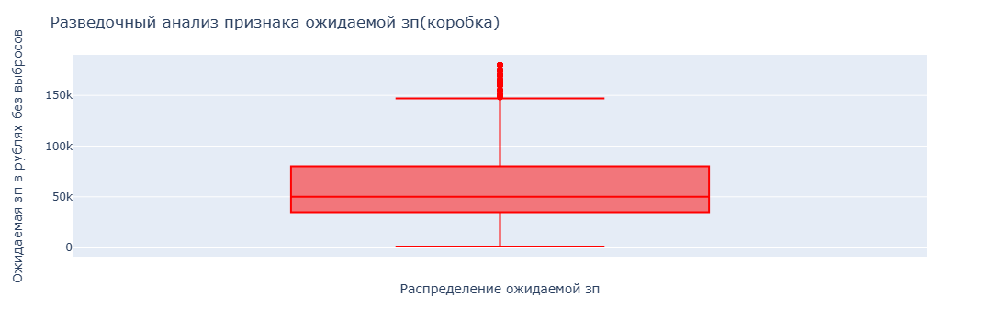

Уже лучше, при этом медиана и 25 процентиль и 75 процентиль почти не пострадали
Это значит, что основное распределение не нарушено


9418

In [151]:
mode_pand = df['ЗП(руб)'].mode()[0]
print(f'Найдем через pandas: мода равна {mode_pand} рублей')
median_pand = df['ЗП(руб)'].median()
print(f'Найдем медиану зп через pandas: равна {median_pand} рублей')
print(f'Это значит, что 50% соискателей хотят зп менее {median_pand} рублей')
perc25_pand = df['ЗП(руб)'].quantile(0.25)
print(f'Найдем 25 квартиль опыта через pandas: равна {perc25_pand} рублей')
perc75_pand = df['ЗП(руб)'].quantile(0.75)
print(f'Найдем 75 квартиль опыта через pandas: равна {perc75_pand} рублей')
min_pand = df['ЗП(руб)'].min()
print(f'Найдем минимальную зп через pandas: равна {min_pand} рублей')
max_pand = df['ЗП(руб)'].max()
print(f'Найдем максимальную зп через pandas: равна {max_pand} рублей')
df_tmp = df[df['ЗП(руб)'] > 1000000]
count_mill = df_tmp['ЗП(руб)'].shape[0]
print(f'Найдем число соискателей с ожиданиями зп > 1.000.000 рублей через pandas: равна {count_mill} человек')

print('Попробуем визуализировать:')

box_plot = px.box(df, y='ЗП(руб)', color_discrete_sequence=['green']) 
box_plot.update_layout(
    xaxis_title="Распределение ожидаемой зарплаты",
    yaxis_title="Ожидаемая зп в рублях",
    title = 'Разведочный анализ признака ожидаемой зп(коробка)'
)
box_plot.show()

print('А теперь откинем значения выше верхней границы межквартильного размаха и построим коробку заново')

tmp_df = df[df['ЗП(руб)'] <= 180000]
box_plot1 = px.box(tmp_df, y='ЗП(руб)', color_discrete_sequence=['red']) 
box_plot1.update_layout(
    xaxis_title="Распределение ожидаемой зп",
    yaxis_title="Ожидаемая зп в рублях без выбросов",
    title = 'Разведочный анализ признака ожидаемой зп(коробка)'
)
box_plot1.show()
print('Уже лучше, при этом медиана и 25 процентиль и 75 процентиль почти не пострадали')
print('Это значит, что основное распределение не нарушено')


del tmp_df
del box_plot
del box_plot1

gc.collect()

1) Большая часть соискателей желает зп от 37082.2 рублей до 95000.0 рублей
2) Чаще всего на рынок труда выходят соискатели с желаниями по зп 59019.0 рублей
3) Ожидания по зп 24 миллиона это выброс, скорее всего, это ошибка(вообще upper_fence показывает, что все, что от 180.000 рублей - частные случаи и выбросы)
4) Конкретно для данного случая коробчатая диаграмма не самое удачное решение из - за большого количества выбросов, так как все, что от 180.000 рублей - выбросы и это портит визуализацию. Можно откинуть выбросы и построить заново, будет наглядно и красиво. Но все равно от 153.000 рублей до 180.000 рублей есть выбросы(но, возможно, частные случаи крутых и редких специалистов). Также понимаем ,что 1 рубль это ошибка данных.
5) Гистограмма тут не подойдет, так как не очень распределение данных(видно на графике). Чтобы показать интервалы распределения зп, проделали тот же трюк, что и с коробкой(отбросиили занчения > 180.000 рублей и построили заново)

4. Постройте диаграмму, которая показывает зависимость **медианной** желаемой заработной платы (**"ЗП (руб)"**) от уровня образования (**"Образование"**). Используйте для диаграммы данные о резюме, где желаемая заработная плата меньше 1 млн рублей.
*Сделайте выводы по представленной диаграмме: для каких уровней образования наблюдаются наибольшие и наименьшие уровни желаемой заработной платы? Как вы считаете, важен ли признак уровня образования при прогнозировании заработной платы?*

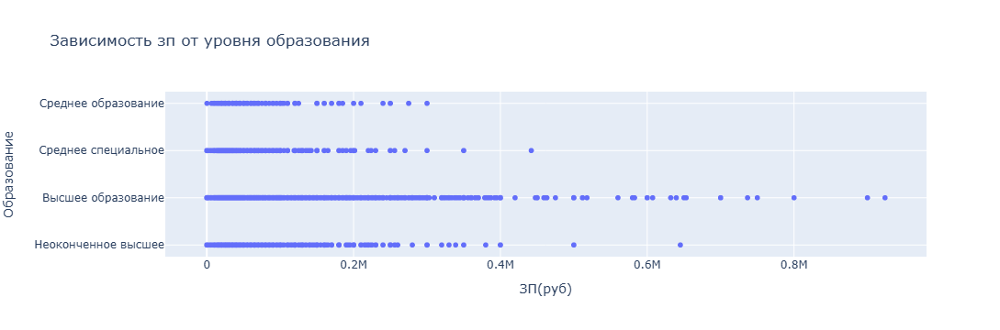

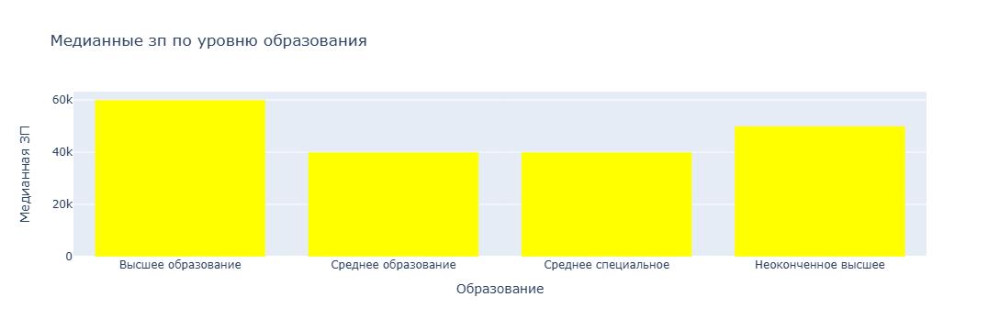

Доля соискателей с высшим образованием  75.68%
Доля соискателей с средним образованием  1.25%
Доля соискателей с средним специальным образованием 12.88%
Доля соискателей с неоконченным высшим образованием  10.18%


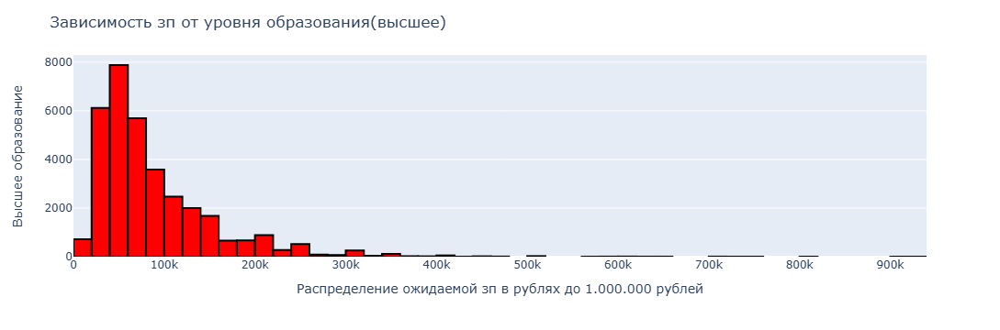

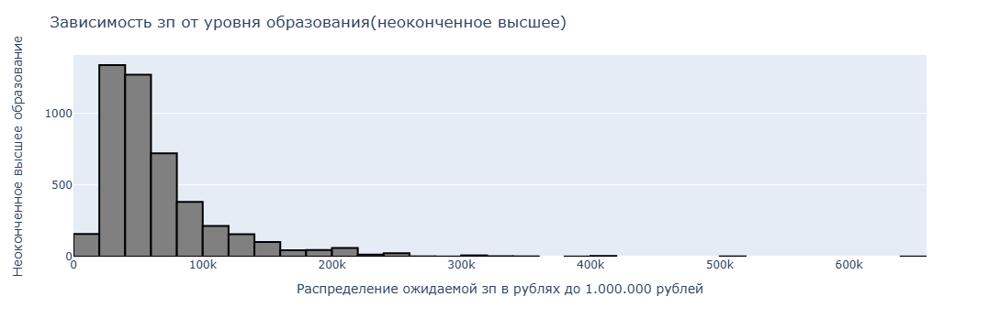

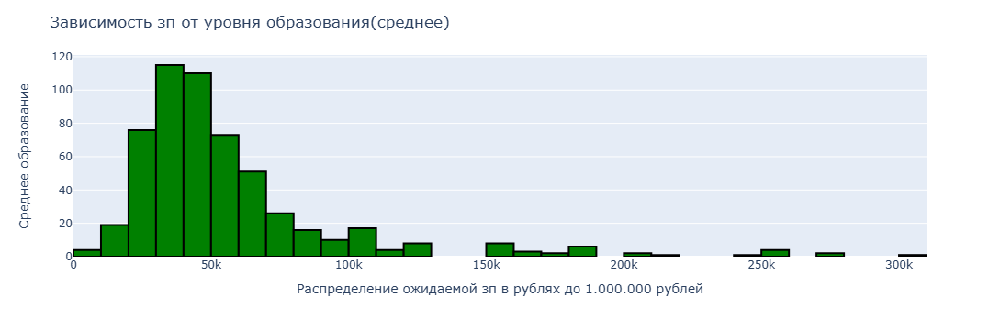

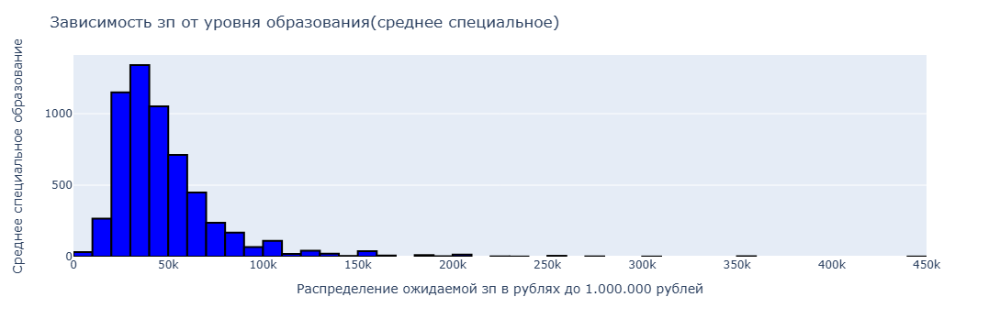

3070

In [138]:

tmp_df = df[df['ЗП(руб)'] < 1000000]
fig = px.scatter(tmp_df, x = 'ЗП(руб)', y = 'Образование', title = 'Зависимость зп от уровня образования')
fig.show()

tmp_df_h = tmp_df[tmp_df['Образование']  == 'Высшее образование']
tmp_df_m = tmp_df[tmp_df['Образование']  == 'Среднее образование']
tmp_df_hs = tmp_df[tmp_df['Образование']  == 'Среднее специальное']
tmp_df_ho = tmp_df[tmp_df['Образование']  == 'Неоконченное высшее']
#делаем преаллок памяти, чтобы не выделял больше, чем нужно, так как знаем число значений
categories = [None] * 4
values = [None] * 4
values[0] = tmp_df_h['ЗП(руб)'].median()
values[1] = tmp_df_m['ЗП(руб)'].median()
values[2] = tmp_df_hs['ЗП(руб)'].median()
values[3] = tmp_df_ho['ЗП(руб)'].median()

categories[0] = 'Высшее образование'
categories[1] = 'Среднее образование'
categories[2] = 'Среднее специальное'
categories[3] = 'Неоконченное высшее'

fig1 = px.bar( x= categories, y=values, title='Медианные зп по уровню образования', labels = {'x': 'Образование', 'y': 'Медианная ЗП'},
             color_discrete_sequence=['yellow'])
part_h = tmp_df_h.shape[0] / tmp_df.shape[0] * 100
part_m = tmp_df_m.shape[0] / tmp_df.shape[0] * 100
part_hs = tmp_df_hs.shape[0] / tmp_df.shape[0] * 100
part_ho = tmp_df_ho.shape[0] / tmp_df.shape[0] * 100
fig1.show()

print(f'Доля соискателей с высшим образованием  {round(part_h,2)}%')
print(f'Доля соискателей с средним образованием  {round(part_m, 2)}%')
print(f'Доля соискателей с средним специальным образованием {round(part_hs,2)}%')
print(f'Доля соискателей с неоконченным высшим образованием  {round(part_ho,2)}%')


zp_plot = px.histogram(tmp_df_h, x = 'ЗП(руб)', nbins = 55, color_discrete_sequence=['red'])
zp_plot.update_layout(
    yaxis_title="Высшее образование", 
    xaxis_title="Распределение ожидаемой зп в рублях до 1.000.000 рублей",
    title = 'Зависимость зп от уровня образования(высшее)')
zp_plot.update_traces(marker_line_color='black',
                  marker_line_width=2)
zp_plot.show()

zp_plot = px.histogram(tmp_df_ho, x = 'ЗП(руб)', nbins = 55, color_discrete_sequence=['gray'])
zp_plot.update_layout(
    yaxis_title="Неоконченное высшее образование", 
    xaxis_title="Распределение ожидаемой зп в рублях до 1.000.000 рублей",
    title = 'Зависимость зп от уровня образования(неоконченное высшее)')
zp_plot.update_traces(marker_line_color='black',
                  marker_line_width=2)
zp_plot.show()

zp_plot = px.histogram(tmp_df_m, x = 'ЗП(руб)', nbins = 55, color_discrete_sequence=['green'])
zp_plot.update_layout(
    yaxis_title="Среднее образование", 
    xaxis_title="Распределение ожидаемой зп в рублях до 1.000.000 рублей",
    title = 'Зависимость зп от уровня образования(среднее)')
zp_plot.update_traces(marker_line_color='black',
                  marker_line_width=2)
zp_plot.show()

zp_plot = px.histogram(tmp_df_hs, x = 'ЗП(руб)', nbins = 55, color_discrete_sequence=['blue'])
zp_plot.update_layout(
    yaxis_title="Среднее специальное образование", 
    xaxis_title="Распределение ожидаемой зп в рублях до 1.000.000 рублей",
    title = 'Зависимость зп от уровня образования(среднее специальное)')
zp_plot.update_traces(marker_line_color='black',
                  marker_line_width=2)
zp_plot.show()


#так как заняли лишнюю память, лучше ее сразу вернуть
del categories
del values
del tmp_df_h
del tmp_df_m 
del tmp_df_hs
del tmp_df_ho
del zp_plot

gc.collect()


Наибольший уровень медианной зп - высшее образование
Наименьшее -  среднее и среднее специальное образование
При этом, соискатели с ожиданиями ЗП до 1.000.000 рублей в основной массе имеют высшее образование(видно на графике и подтверждено расчетами)
Важен ли признак уровня образования при прогнозировании заработной платы? Да, важен, так как, построив распределение(можно коробку или гистограмму, я выбрал гистограмму), видим, что распределения схожи, но у соискателей с высшим и незаконченным высшим образованием в целом больше зарплатные ожидания. Если совсем замучить себя, то можно посчитать размах каждой выборки по ЗП, но это уже лишнее.

5. Постройте диаграмму, которая показывает распределение желаемой заработной платы (**"ЗП (руб)"**) в зависимости от города (**"Город"**). Используйте для диаграммы данные о резюме, где желая заработная плата меньше 1 млн рублей.
*Сделайте выводы по полученной диаграмме: как соотносятся медианные уровни желаемой заработной платы и их размах в городах? Как вы считаете, важен ли признак города при прогнозировании заработной платы?*

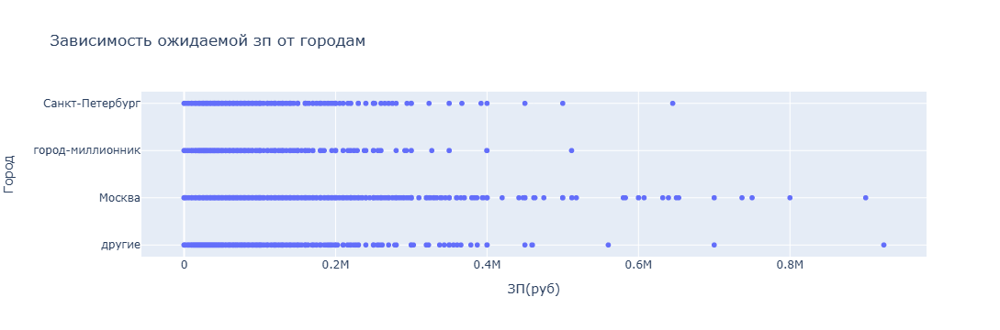

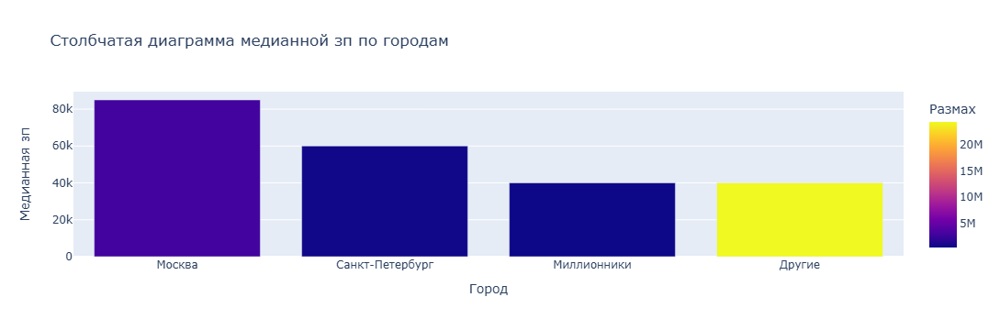

2159

In [139]:
tmp_df = df[df['ЗП(руб)'] < 1000000]
fig = px.scatter(tmp_df, x = 'ЗП(руб)', y = 'Город', title = 'Зависимость ожидаемой зп от городам')
fig.show()

moscow = df[df['Город'] == 'Москва']
spb = df[df['Город'] == 'Санкт-Петербург']
mill = df[df['Город'] == 'город-миллионник']
other = df[df['Город'] == 'другие']

moscow_median = moscow['ЗП(руб)'].median()
spb_median = spb['ЗП(руб)'].median()
mill_median = mill['ЗП(руб)'].median()
other_median = other['ЗП(руб)'].median()

moscow_range = moscow['ЗП(руб)'].max() - moscow['ЗП(руб)'].min()
spb_range = spb['ЗП(руб)'].max() - spb['ЗП(руб)'].min()
mill_range = mill['ЗП(руб)'].max() - mill['ЗП(руб)'].min()
other_range = other['ЗП(руб)'].max() - other['ЗП(руб)'].min()

city = [None] * 4
med_zp = [None] * 4
range = [None] * 4

city[0] = 'Москва'
city[1] = 'Санкт-Петербург'
city[2] = 'Миллионники'
city[3] = 'Другие'

med_zp[0] = moscow_median
med_zp[1] = spb_median
med_zp[2] = mill_median
med_zp[3] = other_median

range[0] = moscow_range
range[1] = spb_range
range[2] = mill_range
range[3] = other_range
data = {
    'Город': city,
    'Медианная зп': med_zp,
    'Размах': range,
}
df1 = pd.DataFrame(data)

fig = px.bar(df1, 
             x='Город', 
             y='Медианная зп', 
             color='Размах', 
             barmode='stack',
             title='Столбчатая диаграмма медианной зп по городам')

fig.show()
del city
del med_zp
del range
del df1
del fig
gc.collect()



Как соотносятся медианные уровни желаемой заработной платы и их размах в городах? - обратная зависимость, чем выше размах, тем ниже медиана.
Как вы считаете, важен ли признак города при прогнозировании заработной платы? - да, важен, так как видим, что наиболее высокие заработки в Москве, Санкт- Петербурге 
Но для городов - миллионников и остальных городов медиана одинакова, а разброс разный.

6. Постройте **многоуровневую столбчатую диаграмму**, которая показывает зависимость медианной заработной платы (**"ЗП (руб)"**) от признаков **"Готовность к переезду"** и **"Готовность к командировкам"**. Проанализируйте график, сравнив уровень заработной платы в категориях.

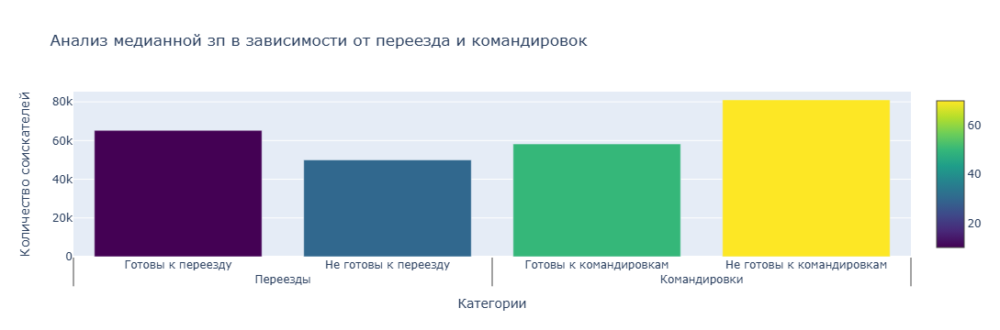

Посмотрим, как поменяется картина, если выделить готовых и к переезду и к командировкам


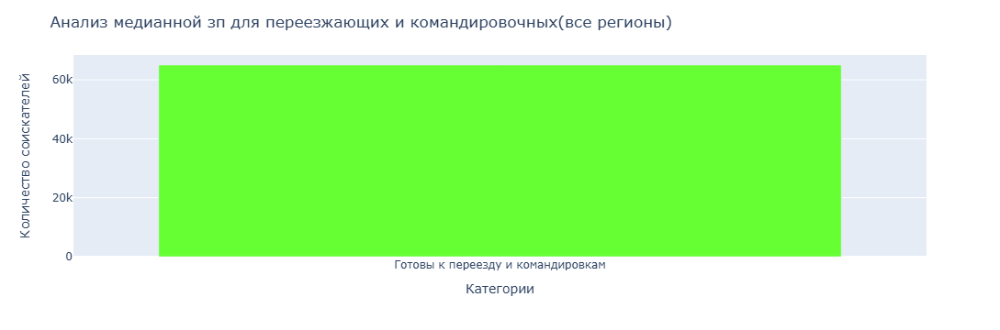

271

In [140]:
#получили срезы готовых и не готовых у переезду и командировках людей
ready_relocate = df[df['Готовность к переезду'] == True]
ready_bis_trip = df[df['Готовность к командировкам'] == True]
not_ready_relocate = df[df['Готовность к переезду'] == False]
not_ready_bis_trip = df[df['Готовность к командировкам'] == False]

#получили медианные зп готовых и не готовых у переезду и командировках людей
ready_relocate_median = ready_relocate['ЗП(руб)'].median()
ready_bis_trip_median = ready_bis_trip['ЗП(руб)'].median()
not_ready_relocate_median = not_ready_relocate['ЗП(руб)'].median()
not_ready_bis_trip_median = not_ready_bis_trip['ЗП(руб)'].median()


# Данные: первый список — основная группа, второй — подгруппа
x = [
    ['Переезды', 'Командировки', 'Переезды', 'Командировки'],
    ['Готовы к переезду', 'Готовы к командировкам', 'Не готовы к переезду', 'Не готовы к командировкам']
]

fig = go.Figure()
fig.add_bar(x=x, y=[ready_relocate_median, ready_bis_trip_median, not_ready_relocate_median, not_ready_bis_trip_median],
            marker=dict(
        color=[10, 50, 30, 70], 
        colorscale='Viridis',       
        showscale=True              
    ))

fig.update_layout(title="Анализ медианной зп в зависимости от переезда и командировок")
fig.update_layout(
    yaxis_title="Количество соискателей",
    xaxis_title="Категории")
fig.show()

print('Посмотрим, как поменяется картина, если выделить готовых и к переезду и к командировкам')

comm1 = (df['Готовность к переезду'] == True) & (df['Готовность к командировкам'] == True)
ready_relocate_bis_trip = df[comm1]

ready_relocate_and_business_trip = ready_relocate_bis_trip['ЗП(руб)'].median()
fig = px.bar(x=['Готовы к переезду и командировкам'], y=[ready_relocate_and_business_trip], color_discrete_sequence = ['#65FF33'])

fig.update_layout(title="Анализ медианной зп для переезжающих и командировочных(все регионы)")
fig.update_layout(
    yaxis_title="Количество соискателей",
    xaxis_title="Категории")
fig.show()


del ready_relocate 
del ready_bis_trip 
del not_ready_relocate 
del not_ready_bis_trip 
del ready_relocate_bis_trip

gc.collect()


Выводы:Если разбить вообще по 4 категориям, то получится следующая градация:
 - Не готовы к переезду(50к)
 - Готовы к командировкам(58к)
 - Готовы к переезду(65к)
 - Не готовы к командировкам(81к)
Но почему - то у меня все равно не получается 66к которую требует ответ на задание(только 65к)
Ответ: медианная желаемая зарплата у соискателей, желающих переехать и готовых к командировкам составляет 65.000 рублей(можно не округлять, так и есть)

7. Постройте сводную таблицу, иллюстрирующую зависимость **медианной** желаемой заработной платы от возраста (**"Возраст"**) и образования (**"Образование"**). На полученной сводной таблице постройте **тепловую карту**. Проанализируйте тепловую карту, сравнив показатели внутри групп.

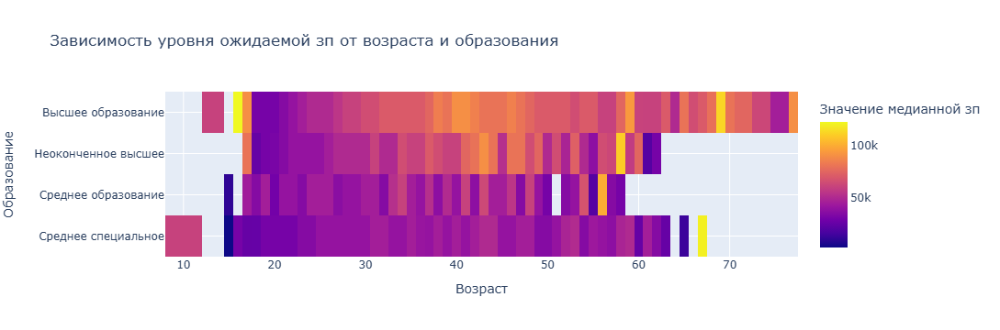

In [141]:
# код был адаптирован из предыдущей дз, проверенной ментором ,комментарии излишни
pivot_salary = df.pivot_table(
    values='ЗП(руб)',              
    index='Образование',      
    columns='Возраст',        
    aggfunc='median'          
)

fig = px.imshow(pivot_salary,
                 labels=dict(x="Возраст", y="Образование", color="Значение медианной зп"),
                 x=pivot_salary.columns,
                 y=pivot_salary.index,
                 title="Зависимость уровня ожидаемой зп от возраста и образования"
                )
fig.show()

del fig

Выводы:

- люди с высшим образованием имеют большие ожидания по зп
- соискатели от 30 лет с неоконченным высшим образованием имеют ожидания по зп выше чем люди с средним или средним специальным образованием
- парадокс в том, что медиана и распределение медианных зп соискателей со средним и средним специальным образованием почти одинаковы, хотя среднее специальное образование предполагает оконченное пту или техникум, что дает рабочие специальности. При этом нет соискателей возраста 51 год
- также соискатели с высшим образованием все еще могут искать работу после 60-67 лет, в то время как остальные уже работу не ищут
- не бывает людей возрастом до 16 лет с средним образованием и до ~ 22 лет с высшим образованием, это ошибочные данные

8. Постройте **диаграмму рассеяния**, показывающую зависимость опыта работы (**"Опыт работы (месяц)"**) от возраста (**"Возраст"**). Опыт работы переведите из месяцев в года, чтобы признаки были в едином масштабе. Постройте на графике дополнительно прямую, проходящую через точки (0, 0) и (100, 100). Данная прямая соответствует значениям, когда опыт работы равен возрасту человека. Точки, лежащие на этой прямой и выше нее - аномалии в наших данных (опыт работы больше либо равен возрасту соискателя)

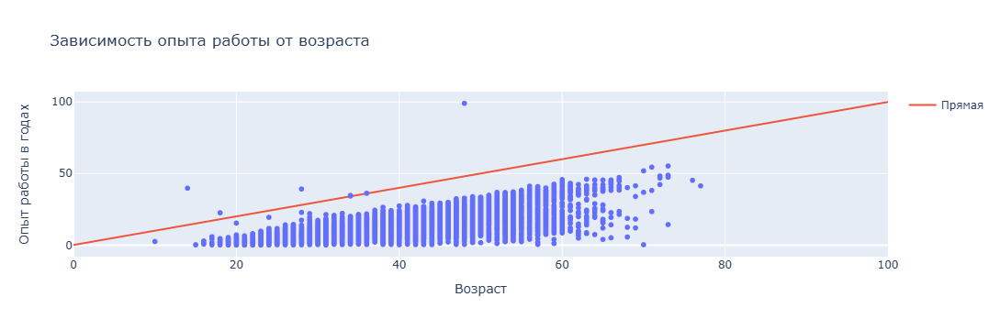

Количество точек выше прямой: 7


In [142]:
df['Опыт работы в годах'] = df['Опыт работы в месяцах'] / 12
fig = px.scatter(df, x = 'Возраст', y = 'Опыт работы в годах', title = 'Зависимость опыта работы от возраста')
fig.add_scatter(x=[0, 100], y=[0, 100], mode='lines', name='Прямая')
fig.show()

mask = df['Возраст'] < df['Опыт работы в годах']
count = mask.sum()

print(f"Количество точек выше прямой: {count}")

df = df.drop('Опыт работы в годах', axis = 1)

Количество точек выше прямой: 7
Переводим на язык клиента: имеем 7 соискателей, которые младше опыта работы - это ошибочные данные, так не бывает.

**Дополнительные баллы**

Для получения 2 дополнительных баллов по разведывательному анализу постройте еще два любых содержательных графика или диаграммы, которые помогут проиллюстрировать влияние признаков/взаимосвязь между признаками/распределения признаков. Приведите выводы по ним. Желательно, чтобы в анализе участвовали признаки, которые мы создавали ранее в разделе "Преобразование данных".


Доля женщин, готовых к переезду 23.8%
Доля мужчин, готовых к переезду 34.34%


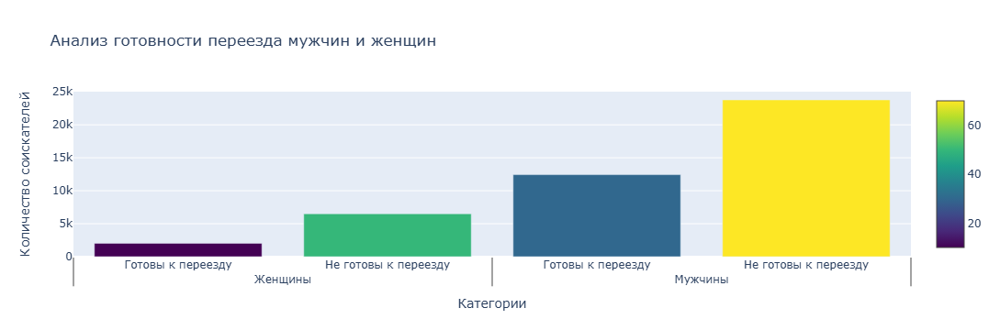

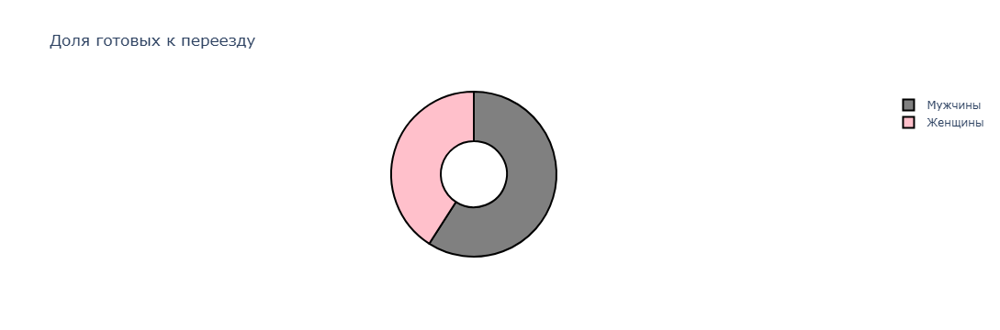

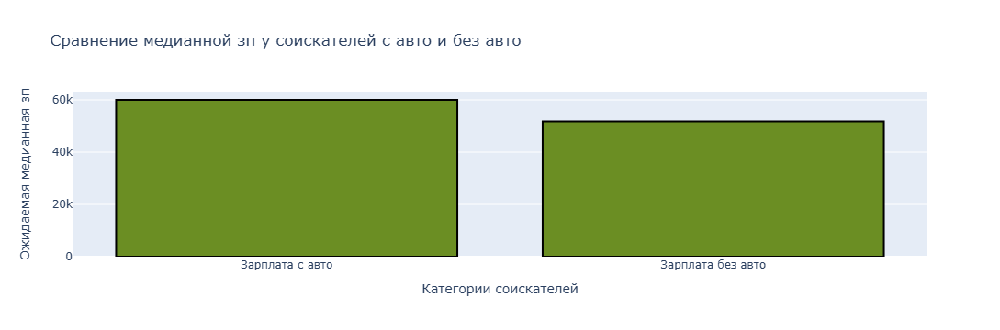

Доля соискателей, имеющих личный автомобиль 27.88%
Доля соискателей, не имеющих личный автомобиль 72.12%


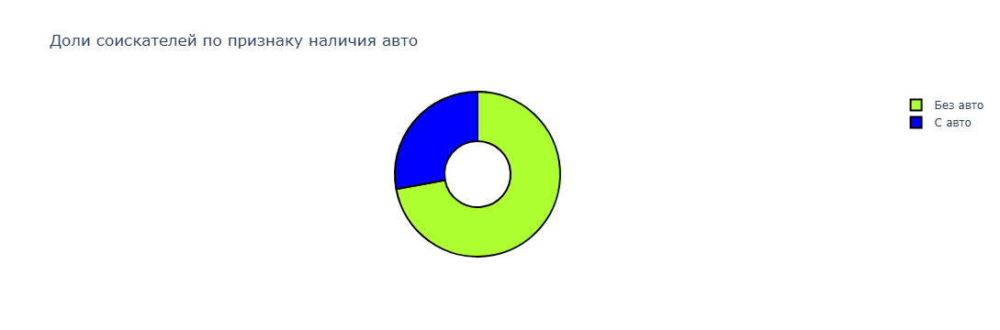

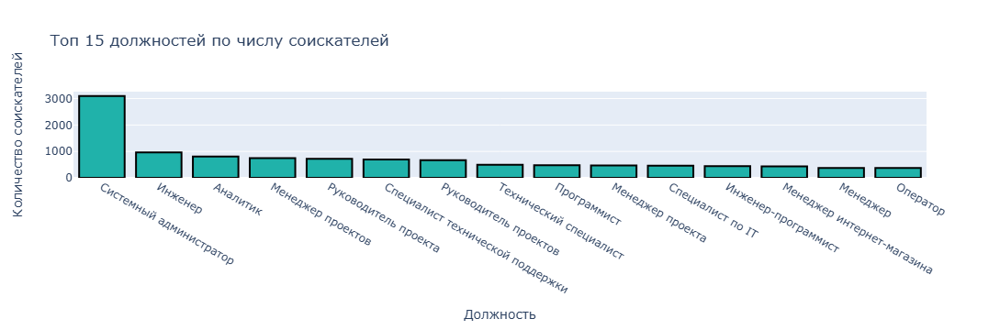

2479

In [143]:
#Пол
#Готовность к переезду
#графики для доп баллов: просиили 2, потроил 5 чтобы уж наверняка +  выводы есть

#подготовка данных к анализу зависимость пола соискателей и готовности к переезду
df_fem_true = df[(df['Пол'] == 'Ж') & (df['Готовность к переезду'] == True)]
fem_true = df_fem_true.shape[0]
del df_fem_true

df_fem_false = df[(df['Пол'] == 'Ж') & (df['Готовность к переезду'] == False)]
fem_false = df_fem_false.shape[0]
del df_fem_false

df_male_true = df[(df['Пол'] == 'М') & (df['Готовность к переезду'] == True)]
male_true = df_male_true.shape[0]
del df_male_true

df_male_false = df[(df['Пол'] == 'М') & (df['Готовность к переезду'] == False)]
male_false = df_male_false.shape[0]
del df_male_false

fem_all = df[df['Пол'] == 'Ж'].shape[0]
male_all = df[df['Пол'] == 'М'].shape[0]
#перед отрисовкой считаем доли формулами
print(f'Доля женщин, готовых к переезду {round(fem_true / fem_all * 100,2)}%')
print(f'Доля мужчин, готовых к переезду {round(male_true / male_all * 100,2)}%')
x = [
    ['Женщины', 'Женщины', 'Мужчины', 'Мужчины'],
    ['Готовы к переезду', 'Не готовы к переезду', 'Готовы к переезду', 'Не готовы к переезду']
]
#отрисовываем столбчатую диаграмму с подкатегориями, чтобы оценить распределение женщин и мужчин готовых/не готовых к переезду
fig = go.Figure()
fig.add_bar(x=x, y=[fem_true, fem_false, male_true, male_false],
            marker=dict(
        color=[10, 50, 30, 70], 
        colorscale='Viridis',       
        showscale=True              
    ))
fig.update_layout(title="Анализ готовности переезда мужчин и женщин")
fig.update_layout(
    yaxis_title="Количество соискателей",
    xaxis_title="Категории")
fig.show()
#отрисовываем круговую диаграмму чтобы узнать, из числа готовых к переезду кого больше, мужчин или женщин
fig = px.pie(values=[round(fem_true / fem_all * 100,2), round(male_true / male_all * 100,2)], names=['Женщины', 'Мужчины'], title='Доля готовых к переезду', color=['Женщины', 'Мужчины'],
            color_discrete_map={'Женщины': 'pink', 'Мужчины': 'gray'})
fig.update_traces(textinfo='none')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_traces(hole=0.4)

fig.show()

#Авто
#ЗП(руб)
#готовим данные для того, чтобы узнать, зависит ли ожидаемая медианная зп от наличия автомобиля
df['Авто'] = df['Авто'].replace('Не указано', False)
df['Авто'] = df['Авто'].replace('Имеется собственный автомобиль', True)

df_auto_true = df[df['Авто'] == True]
df_auto_false = df[df['Авто'] == False]
auto_all = df.shape[0]

auto_true = df_auto_true.shape[0]
auto_false = df_auto_false.shape[0]

zp_median_auto_true = df_auto_true['ЗП(руб)'].median()
zp_median_auto_false = df_auto_false['ЗП(руб)'].median()

x = ['Зарплата с авто', 'Зарплата без авто']
y = [zp_median_auto_true, zp_median_auto_false]
#отрисовываем столбчатую диаграмму чтобы узнать, у кого ожидания зп больше - с авто или без
fig = px.bar(x=x, 
             y=y,  
             title='Сравнение медианной зп у соискателей с авто и без авто')
fig.update_layout(
    yaxis_title="Ожидаемая медианная зп",
    xaxis_title="Категории соискателей")

fig.update_traces(marker_color='#6B8E23')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))

fig.show()

del df_auto_true 
del df_auto_false

print(f'Доля соискателей, имеющих личный автомобиль {round(auto_true / auto_all * 100,2)}%')
print(f'Доля соискателей, не имеющих личный автомобиль {round(auto_false / auto_all * 100,2)}%')
#отрисовываем доли соискателей в зависимости от наличия или отсутствия авто
fig = px.pie(values=[round(auto_true / auto_all * 100,2), round(auto_false / auto_all * 100,2)], names=['С авто', 'Без авто'], title='Доли соискателей по признаку наличия авто', 
            color=['С авто', 'Без авто'],
            color_discrete_map={'С авто': 'blue', 'Без авто': 'GreenYellow'})
fig.update_traces(textinfo='none')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_traces(hole=0.4)
fig.show()

#отрисовываем топ 15 самый востребованных среди соискателей вакансий
dff = df['Ищет работу на должность:'].value_counts().head(15)
fig = px.bar(dff, 
             x = dff.index,
             y=dff.values,  
             title='Топ 15 должностей по числу соискателей')
fig.update_layout(
    yaxis_title="Количество соискателей",
    xaxis_title="Должность")
fig.update_traces(marker_color='#20B2AA')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.show()

del dff

gc.collect()

1) Мужчины более готовы к переезду, чем женщины(посчитана доля и отображена на диаграмме). При этом большинство соискателей не готовы переезжать в принципе.
2) Большая часть соискателей не имеет автомобилей(если не указали, считаем, что нет). Но на зарплатные ожидания это сильно не влияет(очень слабая зависимость). Вообще, этот признак оказался бесполезным и я бы рекомендовал его удалить.
3) При анализе желаемой должности приходим у выводу, что или выгрузили так специально, или на рынок вышли специалисты технического профиля(топ 15 желаемых должностей из ИТ сектора)

# Очистка данных

1. Начнем с дубликатов в наших данных. Найдите **полные дубликаты** в таблице с резюме и удалите их. 

In [144]:
#нашли и удалили 161 дубликат
print(df.duplicated().sum())
print(df.shape[0])
df = df.drop_duplicates()
print(df.shape[0])

161
44744
44583


2. Займемся пропусками. Выведите информацию **о числе пропусков** в столбцах. 

In [145]:
print(df.isna().sum())

Ищет работу на должность:            0
Последнее/нынешнее место работы      1
Последняя/нынешняя должность         2
Обновление резюме                    0
Авто                                 0
Образование                          0
Пол                                  0
Возраст                              0
Опыт работы в месяцах              168
Город                                0
Готовность к переезду                0
Готовность к командировкам           0
Полная занятость                     0
Частичная занятость                  0
Проектная работа                     0
Стажировка                           0
Волонтерство                         0
вахтовый метод                       0
гибкий график                        0
удалённая работа                     0
полная занятость                     0
ЗП(руб)                              0
dtype: int64


3. Итак, у нас есть пропуски в 3ех столбцах: **"Опыт работы (месяц)"**, **"Последнее/нынешнее место работы"**, **"Последняя/нынешняя должность"**. Поступим следующим образом: удалите строки, где есть пропуск в столбцах с местом работы и должностью. Пропуски в столбце с опытом работы заполните **медианным** значением.

In [146]:
df = df.dropna(subset=['Последнее/нынешнее место работы'])
df = df.dropna(subset=['Последняя/нынешняя должность'])
skill_median = df['Опыт работы в месяцах'].median()
df['Опыт работы в месяцах'] = df['Опыт работы в месяцах'].fillna(skill_median)
#убеждаемся ,что мы все заполнили
print(df.isna().sum())
skill_mean = df['Опыт работы в месяцах'].mean()
print(f'Средний опыт работы в месяцах после заполнения: {int(skill_mean)}')

Ищет работу на должность:          0
Последнее/нынешнее место работы    0
Последняя/нынешняя должность       0
Обновление резюме                  0
Авто                               0
Образование                        0
Пол                                0
Возраст                            0
Опыт работы в месяцах              0
Город                              0
Готовность к переезду              0
Готовность к командировкам         0
Полная занятость                   0
Частичная занятость                0
Проектная работа                   0
Стажировка                         0
Волонтерство                       0
вахтовый метод                     0
гибкий график                      0
удалённая работа                   0
полная занятость                   0
ЗП(руб)                            0
dtype: int64
Средний опыт работы в месяцах после заполнения: 114


4. Мы добрались до ликвидации выбросов. Сначала очистим данные вручную. Удалите резюме, в которых указана заработная плата либо выше 1 млн. рублей, либо ниже 1 тыс. рублей.

In [147]:
comm1 = (df['ЗП(руб)'] <= 1000000) & (df['ЗП(руб)'] >= 1000)
old = df.shape[0]
df = df[comm1]
new = df.shape[0]

print(f'Удалили {old - new} выбросов')

Удалили 89 выбросов


5. В процессе разведывательного анализа мы обнаружили резюме, в которых **опыт работы в годах превышал возраст соискателя**. Найдите такие резюме и удалите их из данных


In [148]:
df['Опыт работы в годах'] = df['Опыт работы в месяцах'] / 12
mask = df['Возраст'] > df['Опыт работы в годах']
old = df.shape[0]
df = df[mask]

new = df.shape[0]
print(f'Удалили {old - new} выбросов')
df = df.drop('Опыт работы в годах', axis = 1)

Удалили 7 выбросов


6. В результате анализа мы обнаружили потенциальные выбросы в признаке **"Возраст"**. Это оказались резюме людей чересчур преклонного возраста для поиска работы. Попробуйте построить распределение признака в **логарифмическом масштабе**. Добавьте к графику линии, отображающие **среднее и границы интервала метода трех сигм**. Напомним, сделать это можно с помощью метода axvline. Например, для построение линии среднего будет иметь вид:

`histplot.axvline(log_age.mean(), color='k', lw=2)`

В какую сторону асимметрично логарифмическое распределение? Напишите об этом в комментарии к графику.
Найдите выбросы с помощью метода z-отклонения и удалите их из данных, используйте логарифмический масштаб. Давайте сделаем послабление на **1 сигму** (возьмите 4 сигмы) в **правую сторону**.

Выведите таблицу с полученными выбросами и оцените, с каким возрастом соискатели попадают под категорию выбросов?

Выбросов методом 3-х сигм 3 соискателей
Корректных соискателей методом 3-х сигм 44482 соискателей
Вот выбросы
31137    15
32950    15
33654    10
Name: Возраст, dtype: int32
Выбросами стали соискатели 15 и 10 лет


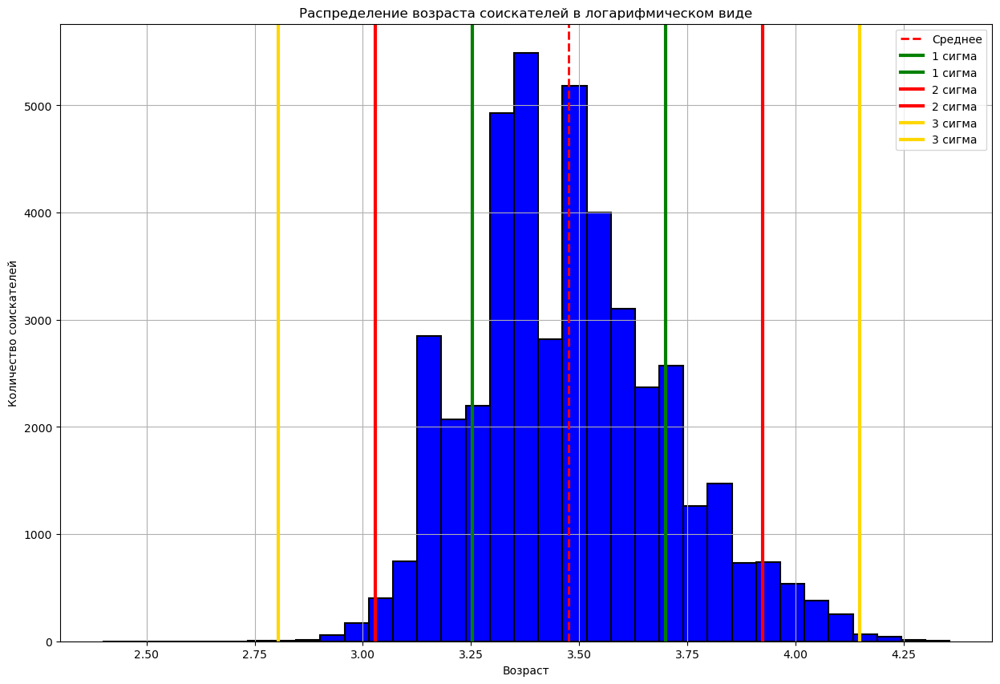

Видим смещение вправо, поэтому по заданию ослабляли вправо сигму до 4-х


In [149]:
#ранее уже писали эту функцию, поэтому используем повторно для текущих нужд
def outliers_z_score_mod(data, feature, log_scale=False, left = 3, right = 3):
    if log_scale:
        x = np.log(data[feature]+1)
    else:
        x = data[feature]

    mean_ = x.mean()
    sigma = x.std()
    boundl = mean_ - left * sigma
    boundu = mean_ + right * sigma
    outliers = data[(x < boundl) | (x > boundu)]
    cleaned = data[(x >= boundl) & (x <= boundu)]
    return outliers, cleaned
#функция для преобразования столбца к логарифмическому виду
def log(data, feature):
    return np.log(data[feature]+1)
#расширяем тип данных чтобв избежать переполнения и оцениваем выбросы    
df['Возраст'] = df['Возраст'].astype(np.int32)
outliers, cleaned = outliers_z_score_mod(df, 'Возраст', log_scale=True, left = 3, right = 4)
print(f'Выбросов методом 3-х сигм {outliers.shape[0]} соискателей')
print(f'Корректных соискателей методом 3-х сигм {cleaned.shape[0]} соискателей')

print('Вот выбросы')
print(outliers['Возраст'])
print('Выбросами стали соискатели 15 и 10 лет')
#считаем среднее и сигму для отображения на графике
tmp_df['Возраст'] = log(df, 'Возраст')
tmp_mean = tmp_df['Возраст'].mean()
tmp_std = tmp_df['Возраст'].std()
#создание диаграммы(код адаптирован из предыдущих дз)
plt.figure(figsize=(15, 10))
plt.hist(tmp_df['Возраст'], bins=35, color='blue', edgecolor='black', linewidth=1.5)
plt.grid(True)
plt.title('Распределение возраста соискателей в логарифмическом виде')
plt.xlabel('Возраст')
plt.ylabel('Количество соискателей')
plt.axvline(tmp_mean, color='red', linestyle='--', label='Среднее', linewidth=2)
plt.axvline((tmp_mean - tmp_std), color='green', linestyle='-', label='1 сигма', linewidth=3)
plt.axvline((tmp_mean + tmp_std), color='green', linestyle='-', label='1 сигма', linewidth=3)
plt.axvline((tmp_mean - 2 * tmp_std), color='red', linestyle='-', label='2 сигма', linewidth=3)
plt.axvline((tmp_mean + 2 * tmp_std), color='red', linestyle='-', label='2 сигма', linewidth=3)
plt.axvline((tmp_mean - 3 * tmp_std), color='Gold', linestyle='-', label='3 сигма', linewidth=3)
plt.axvline((tmp_mean + 3 * tmp_std), color='Gold', linestyle='-', label='3 сигма', linewidth=3)
plt.legend()
plt.show() 

print('Видим смещение вправо, поэтому по заданию ослабляли вправо сигму до 4-х')

ваш коммментарий здесь

Видим смещение вправо, поэтому по заданию ослабляли вправо сигму до 4-х
Выбросами стали соискатели 15 и 10 лет в количестве 3-х соискателей